In [1]:
import numpy as np
import pandas as pd
from metrics import *
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
import seaborn as sns
import plotly_express as px

In [12]:
# load the iris dataset
iris_data = load_iris() 
df_data = pd.DataFrame(data= np.c_[iris_data['data'], iris_data['target']],
                     columns= iris_data['feature_names'] + ['target'])
# drop target
df_data = df_data.drop(columns=['target'])

In [3]:
# Finding the distance between two points
n = df_data.shape[0]
euclidean_dist_list = np.zeros((n, n))
manhattan_dist_list = np.zeros((n, n))
mahalanobis_dist_list = np.zeros((n, n))
cosine_dist_list = np.zeros((n, n))
jaccard_dist_list = np.zeros((n, n))
jaccard_simil_list = np.zeros((n, n))
for i in range(n):
    for j in range(n):
        euclidean_dist_list[i, j] = euclidean_distance(df_data.iloc[i, 0:4], df_data.iloc[j, 0:4])
        manhattan_dist_list[i, j] = manhattan_distance(df_data.iloc[i, 0:4], df_data.iloc[j, 0:4])
        mahalanobis_dist_list[i, j] = mahalanobis_distance(df_data.iloc[i, 0:4], df_data.iloc[j, 0:4], np.cov(df_data.iloc[:, 0:4].T))
        cosine_dist_list[i, j] = cosine_similarity(df_data.iloc[i, 0:4], df_data.iloc[j, 0:4])
        jaccard_dist_list[i, j] = jaccard_distance(df_data.iloc[i, 0:4], df_data.iloc[j, 0:4])
        jaccard_simil_list[i, j] = jaccard_similarity(df_data.iloc[i, 0:4], df_data.iloc[j, 0:4])

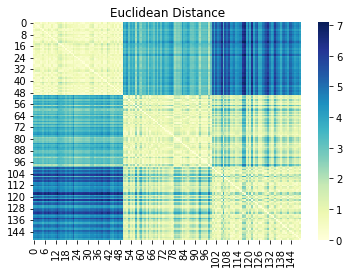

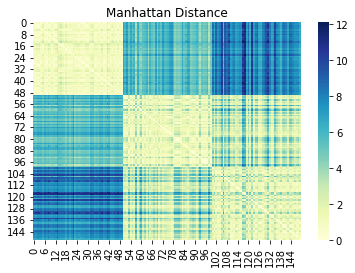

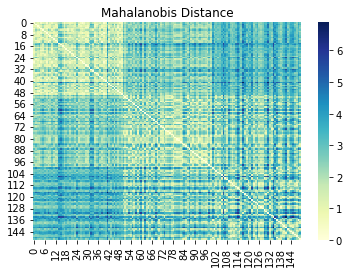

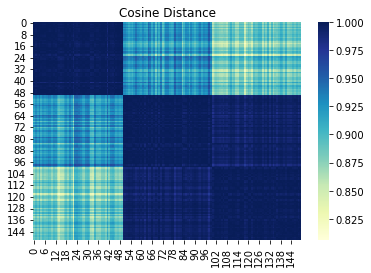

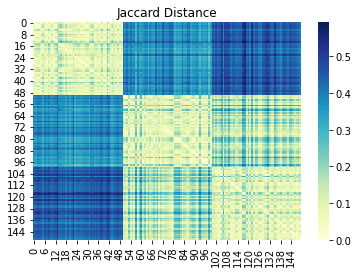

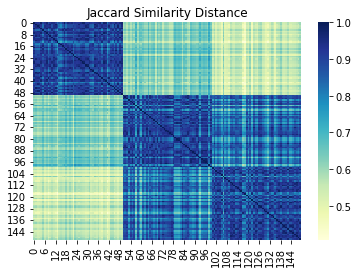

In [4]:
distance_list = [euclidean_dist_list, manhattan_dist_list, mahalanobis_dist_list, cosine_dist_list, jaccard_dist_list, jaccard_simil_list]
dist_names = ['Euclidean','Manhattan','Mahalanobis','Cosine','Jaccard','Jaccard Similarity']
for i in range(len(distance_list)):
    plt.figure()
    plt.title(f'{dist_names[i]} Distance')
    sns.heatmap(distance_list[i], cmap="YlGnBu");
    plt.show()

### K-means clustering

In [4]:
# K-means clustering
def kmeans_clustering(data, k, max_iter=100,metric='euclidean'):
    n = data.shape[0]
    m = data.shape[1]
    centroids = np.zeros((k, m))
    for i in range(k):
        centroids[i, :] = data.iloc[np.random.randint(0, n), :]
    for i in range(max_iter):
        cluster_list = np.zeros((n, 1))
        for j in range(n):
            min_dist = np.inf
            for l in range(k):
                dist = similarity(data.iloc[j, :], centroids[l, :], metric)
                if dist < min_dist:
                    min_dist = dist
                    cluster_list[j, 0] = l
        for j in range(k):
            centroids[j, :] = np.mean(data.iloc[np.where(cluster_list[:, 0] == j)[0], :], axis=0)
    return cluster_list

### Fuzzy C means clustering

In [5]:
# Fuzzy C-means clustering
def fuzzy_cmeans_clustering(data, k, m, max_iter=100, metric='euclidean'):
    n = data.shape[0]
    m = data.shape[1]
    centroids = np.zeros((k, m))
    for i in range(k):
        centroids[i, :] = data.iloc[np.random.randint(0, n), :]
    u = np.zeros((n, k))
    for i in range(max_iter):
        for j in range(n):
            for l in range(k):
                u[j, l] = 1 / np.sum([np.power(similarity(data.iloc[j, :], centroids[l, :],metric) / similarity(data.iloc[j, :], centroids[k, :],metric), 2 / (m - 1)) for k in range(k)])
        for j in range(k):
            centroids[j, :] = np.sum([np.power(u[j, l], m) * data.iloc[l, :] for l in range(n)], axis=0) / np.sum([np.power(u[j, l], m) for l in range(n)])
    return u

### Mountain clustering

In [6]:
# Mountain clustering
def mountain_clustering(data, k, max_iter=100,metric='euclidean'):
    n = data.shape[0]
    m = data.shape[1]
    centroids = np.zeros((k, m))
    for i in range(k):
        centroids[i, :] = data.iloc[np.random.randint(0, n), :]
    u = np.zeros((n, k))
    for i in range(max_iter):
        for j in range(n):
            for l in range(k):
                u[j, l] = 1 / np.sum([np.power(similarity(data.iloc[j, :], centroids[l, :],metric) / similarity(data.iloc[j, :], centroids[k, :],metric), 2) for k in range(k)])
        for j in range(k):
            centroids[j, :] = np.sum([np.power(u[j, l], 2) * data.iloc[l, :] for l in range(n)], axis=0) / np.sum([np.power(u[j, l], 2) for l in range(n)])
    return u

### Subtractive clustering

In [7]:
# Subtractive clustering
def subtractive_clustering(data, k, max_iter=100):
    n = data.shape[0]
    m = data.shape[1]
    centroids = np.zeros((k, m))
    for i in range(k):
        centroids[i, :] = data.iloc[np.random.randint(0, n), :]
    for i in range(max_iter):
        cluster_list = np.zeros((n, 1))
        for j in range(n):
            min_dist = np.inf
            for l in range(k):
                dist = euclidean_distance(data.iloc[j, :], centroids[l, :])
                if dist < min_dist:
                    min_dist = dist
                    cluster_list[j, 0] = l
        for j in range(k):
            centroids[j, :] = np.mean(data.iloc[np.where(cluster_list[:, 0] == j)[0], :], axis=0)
        centroids = np.delete(centroids, np.where(np.sum(np.abs(centroids), axis=1) == 0)[0], axis=0)
        k = centroids.shape[0]
    return cluster_list

### Normalize data

In [9]:
def normalize(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

### DBSCAN clustering

In [8]:
def dbscan_clustering(eps,data,min_points,metric='euclidean'):
    n = data.shape[0]
    cluster_list = np.zeros((n, 1))
    cluster = 0
    for i in range(n):
        if cluster_list[i, 0] == 0:
            neighbors = np.where(data.apply(lambda x: similarity(x, data.iloc[i, :], metric) < eps, axis=1))[0]
            if len(neighbors) < min_points:
                cluster_list[i, 0] = -1
            else:
                cluster += 1
                cluster_list[i, 0] = cluster
                for j in neighbors:
                    if cluster_list[j, 0] == 0:
                        cluster_list[j, 0] = cluster
                        neighbors2 = np.where(data.apply(lambda x: similarity(x, data.iloc[j, :], metric) < eps, axis=1))[0]
                        if len(neighbors2) >= min_points:
                            neighbors = np.append(neighbors, neighbors2)
                    elif cluster_list[j, 0] == -1:
                        cluster_list[j, 0] = cluster
    return cluster_list


In [ ]:
# calculate similarity matrix
def similarity_matrix(data,similarity):
    n = data.shape[0]
    similarity_matrix = np.zeros((n, n))
    for i in range(n):
        for j in range(i + 1, n):
            similarity_matrix[i, j] = similarity(data.iloc[i, :], data.iloc[j, :])
            similarity_matrix[j, i] = similarity_matrix[i, j]
    return similarity_matrix


In [14]:
cluster_list = kmeans_clustering(df_data, 3, metric='euclidean')
unsupervised_cluster = pd.concat([df_data, pd.DataFrame(cluster_list)], axis=1)
unsupervised_cluster.columns.values[-1] = 'Cluster'
unsupervised_cluster.head()


,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),Cluster
0,5.1,3.5,1.4,0.2,0.0
1,4.9,3.0,1.4,0.2,0.0
2,4.7,3.2,1.3,0.2,0.0
3,4.6,3.1,1.5,0.2,0.0
4,5.0,3.6,1.4,0.2,0.0


## Euclidean distance

In [11]:
cluster_list = dbscan_clustering(1.85,df_data.drop(['target'],axis=1),7)

In [12]:
data = df_data.drop(['target'],axis=1)
unsupervised_cluster = pd.concat([data, pd.DataFrame(cluster_list)], axis=1)
unsupervised_cluster.columns.values[-1] = 'Cluster'
unsupervised_cluster.head()


,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),Cluster
0,5.1,3.5,1.4,0.2,1.0
1,4.9,3.0,1.4,0.2,1.0
2,4.7,3.2,1.3,0.2,1.0
3,4.6,3.1,1.5,0.2,1.0
4,5.0,3.6,1.4,0.2,1.0


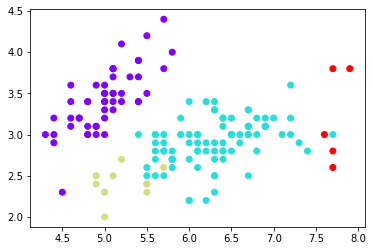

In [13]:
plt.scatter(unsupervised_cluster['sepal length (cm)'], unsupervised_cluster['sepal width (cm)'], c=unsupervised_cluster['Cluster'], cmap='rainbow')

In [14]:
len(set(unsupervised_cluster['Cluster']))

4

### Manhattan Distance

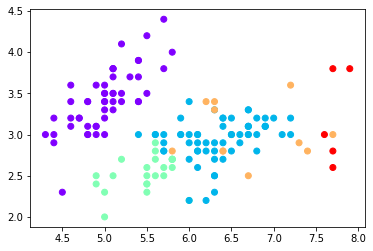

In [15]:
cluster_list = dbscan_clustering(2.5,df_data.drop(['target'],axis=1),7,'manhattan')
data = df_data.drop(['target'],axis=1)
unsupervised_cluster = pd.concat([data, pd.DataFrame(cluster_list)], axis=1)
unsupervised_cluster.columns.values[-1] = 'Cluster'
plt.scatter(unsupervised_cluster['sepal length (cm)'], unsupervised_cluster['sepal width (cm)'], c=unsupervised_cluster['Cluster'], cmap='rainbow')

In [16]:
len(set(unsupervised_cluster['Cluster']))

5

In [9]:
def plot3D(df,X,Y,Z,color):
    return px.scatter_3d(df,x=X,y=Y,z=Z,color=color,opacity=0.5)

In [21]:
data = pd.read_csv('all_patients_fiducial_points.csv')
data = data[data.Class == 0]
data = data.drop(['Class'],axis=1)

In [ ]:
# Change class names
# data['Class'] = data['Class'].replace(0, 'personal trait 0')
# data['Class'] = data['Class'].replace(1, 'personal trait 1')
# data['Class'] = data['Class'].replace(2, 'personal trait 2')
# data['Class'] = data['Class'].replace(3, 'personal trait 3')
# data['Class'] = data['Class'].replace(4, 'personal trait 4')

In [23]:
data.drop(['Unnamed: 0'],axis=1,inplace=True)

In [47]:
data

,P1,P,P2,Q,R,S,T1,T
0,-0.000822,0.131579,0.239309,0.265625,0.312500,0.351974,0.703125,0.868421
1,-0.000824,0.131904,0.239901,0.266282,0.313273,0.352844,0.703215,0.868920
2,-0.000827,0.132341,0.240695,0.267163,0.314309,0.354012,0.703060,0.869313
3,-0.000832,0.133111,0.242097,0.267887,0.315308,0.355241,0.707155,0.870216
4,-0.000836,0.133779,0.243311,0.269231,0.316890,0.357023,0.709030,0.872074
...,...,...,...,...,...,...,...,...
10240,-0.000945,0.151229,0.247637,0.327977,0.384688,0.432892,0.636106,0.826087
10241,-0.000993,0.107249,0.222443,0.293942,0.352532,0.403178,0.618669,0.818272
10242,-0.000949,0.151803,0.259962,0.328273,0.384250,0.432638,0.637571,0.828273
10243,-0.000968,0.136496,0.244918,0.317522,0.374637,0.424008,0.631171,0.825750


In [21]:
data = pd.read_csv('all_patients_fiducial_points.csv')
data = data[data.Class == 0]
data = data.drop(['Class'],axis=1)
data.drop(['Unnamed: 0'],axis=1,inplace=True)

In [22]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.35, min_samples=5)
cluster_list = dbscan.fit_predict(data)  
cluster_list = pd.DataFrame(cluster_list)

data = pd.concat([data, cluster_list], axis=1)
data.columns.values[-1] = 'Cluster'
data['Cluster'] = data['Cluster'].replace(0, 'personal trait 0')
data['Cluster'] = data['Cluster'].replace(1, 'personal trait 1')
data['Cluster'] = data['Cluster'].replace(2, 'personal trait 2')
data['Cluster'] = data['Cluster'].replace(3, 'personal trait 3')
data['Cluster'] = data['Cluster'].replace(4, 'personal trait 4')
 
plot3D(data,'P','Q','R','Cluster')

In [61]:
data = pd.read_csv('all_patients_fiducial_points.csv')
data = data[data.Class == 0]
data = data.drop(['Class'],axis=1)
data.drop(['Unnamed: 0'],axis=1,inplace=True)


from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.2, min_samples=3)
cluster_list = dbscan.fit_predict(data)  
cluster_list = pd.DataFrame(cluster_list)

data = pd.concat([data, cluster_list], axis=1)
data.columns.values[-1] = 'Cluster'
 
plot3D(data,'P','Q','R','Cluster')
#del data

In [4]:
# use kmeans for better results

data = pd.read_csv('all_patients_fiducial_points.csv')
data = data[data.Class == 0]
data = data.drop(['Class'],axis=1)
data.drop(['Unnamed: 0'],axis=1,inplace=True)

from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5, random_state=0).fit(data)
cluster_list = kmeans.predict(data)
cluster_list = pd.DataFrame(cluster_list)

data = pd.concat([data, cluster_list], axis=1)
data.columns.values[-1] = 'Cluster'
data['Cluster'] = data['Cluster'].replace(0, 'personal trait 0')
data['Cluster'] = data['Cluster'].replace(1, 'personal trait 1')
data['Cluster'] = data['Cluster'].replace(2, 'personal trait 2')
data['Cluster'] = data['Cluster'].replace(3, 'personal trait 3')
data['Cluster'] = data['Cluster'].replace(4, 'personal trait 4')

plot3D(data,'P','Q','R','Cluster')

In [10]:
plot3D(data,'Q','S','P','Cluster')

In [14]:
# data to csv
data.to_csv('healthy_5_labels.csv')

In [18]:
data

,P,Q,Rav,S,T,T1,T2,P1,P2,S2,Cluster
0,0.003061,0.003491,0.003491,0.003901,0.004215,0.004233,0.004401,0.003061,0.002968,0.003994,4
1,0.006552,0.006982,0.006982,0.007355,0.007684,0.007609,0.007870,0.006552,0.006458,0.007503,4
2,0.010042,0.010473,0.010474,0.010883,0.011153,0.011077,0.011339,0.010042,0.009967,0.011031,4
3,0.012226,0.012228,0.012061,0.012301,0.012346,0.012401,0.012253,0.012226,0.012244,0.012450,4
4,0.013533,0.013964,0.013965,0.014373,0.014640,0.014565,0.014827,0.013533,0.013457,0.014484,4
...,...,...,...,...,...,...,...,...,...,...,...
75742,0.293711,0.293246,0.293262,0.293624,0.293118,0.293493,0.293310,0.293706,0.293492,0.293564,0
75743,0.297202,0.296737,0.296753,0.297114,0.296606,0.296981,0.296798,0.297196,0.296982,0.297055,0
75744,0.300693,0.300228,0.300245,0.300605,0.300093,0.300468,0.300285,0.300687,0.300472,0.300545,0
75745,0.304183,0.303719,0.303736,0.304095,0.303581,0.303955,0.303773,0.304177,0.303962,0.304035,0


In [2]:
# read arrhytmias csv
df_arr = pd.read_csv('arrhythmias_2.csv')
# drop type colummn
df_arr = df_arr.drop(['type'],axis=1)

In [11]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5, random_state=0).fit(df_arr)
cluster_list = kmeans.predict(df_arr)
cluster_df = pd.DataFrame(cluster_list)

data = pd.concat([df_arr, cluster_df], axis=1)
data.columns.values[-1] = 'Cluster'




In [17]:
plot3D(data,'P','T','S','Cluster')

In [21]:
plot3D(data,'T2','S','Q','Cluster')

In [12]:
import umap
def umap_projection(data, labels, n_neighbors=15, min_dist=0.1, n_components=2, metric='euclidean'):
    reducer = umap.UMAP(
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        n_components=n_components,
        metric=metric)
    embedding = reducer.fit_transform(data)
    plt.scatter(
        embedding[:, 0],
        embedding[:, 1],
        c=[sns.color_palette()[x] for x in labels])
    plt.gca().set_aspect('equal', 'datalim')
    plt.title('UMAP projection', fontsize=24)

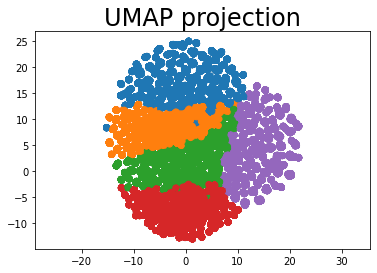

In [13]:
umap_projection(data,cluster_list)